# Set up for the analysis

In [1]:
cd /workspace

/workspace


In [2]:
import scanpy as sc
import pandas as pd
import seaborn as sns
import matplotlib
from matplotlib.pyplot import rc_context
import matplotlib.pyplot as plt
import os

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.figdir='./out/human_only'
sc.settings.set_figure_params(dpi=100, dpi_save=300,fontsize=12, frameon=False, facecolor='white', format='png', color_map='Reds')



In [3]:
print(sc.settings.figdir)

out/human_only


In [4]:
results_file = 'data/MSODB_human.h5ad'  # the file that will store the analysis results
pp_file = 'data/PP_MSOD_human.h5ad'


In [5]:
filtered_human = sc.read_h5ad('./data/Human_filtered.h5ad')
filtered_human

AnnData object with n_obs × n_vars = 3225 × 25864
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_human', 'pct_counts_human', 'total_counts_mouse', 'pct_counts_mouse'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'human', 'mouse', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [6]:
adata = sc.read_10x_mtx('./data/humanHg38/')

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [7]:
adata=adata[adata.obs_names.isin(filtered_human.obs_names)]

In [8]:
del(filtered_human)
adata

View of AnnData object with n_obs × n_vars = 3197 × 36601
    var: 'gene_ids', 'feature_types'

In [9]:
adata.obs_names_make_unique()
adata

AnnData object with n_obs × n_vars = 3197 × 36601
    var: 'gene_ids', 'feature_types'

In [10]:
adata.obs_names_make_unique()
adata.var_names_make_unique()
adata.var.index.is_unique
adata

AnnData object with n_obs × n_vars = 3197 × 36601
    var: 'gene_ids', 'feature_types'

In [11]:
cell_cycle_genes = [x.strip() for x in open('./data/CellCycleGenes.txt')]

In [12]:
s_genes = cell_cycle_genes[:40]
g2m_genes = cell_cycle_genes[40:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

# Check how the genes are annotated and count the different sources

In [13]:
adata.var_names

Index(['MIR1302-2HG', 'FAM138A', 'OR4F5', 'AL627309.1', 'AL627309.3',
       'AL627309.2', 'AL627309.5', 'AL627309.4', 'AP006222.2', 'AL732372.1',
       ...
       'AC133551.1', 'AC136612.1', 'AC136616.1', 'AC136616.3', 'AC136616.2',
       'AC141272.1', 'AC023491.2', 'AC007325.1', 'AC007325.4', 'AC007325.2'],
      dtype='object', length=36601)

# Plot highest expressed genes and count 

normalizing counts per cell
    finished (0:00:00)


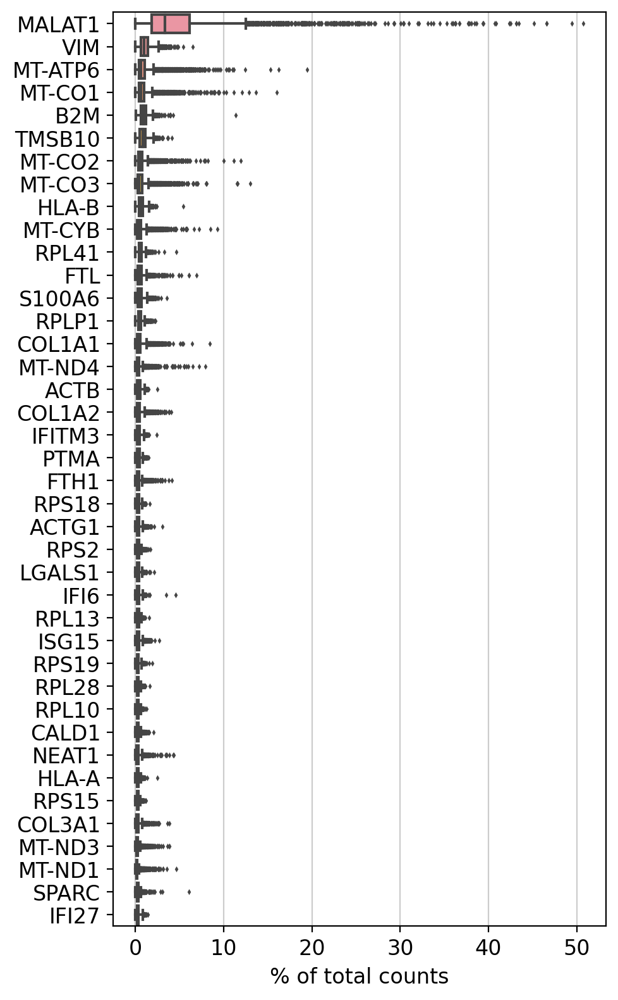

filtered out 17547 genes that are detected in less than 5 cells


AnnData object with n_obs × n_vars = 3197 × 19054
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [14]:
sc.pl.highest_expr_genes(adata, n_top=40,save='mouse_MSOD' )
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_cells(adata, min_counts=200)
sc.pp.filter_genes(adata, min_cells=5)
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
adata

# Plot number of counts per cell, genes and percentage of mitochondrial, human and mouse cells

/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'feature_types' as categorical


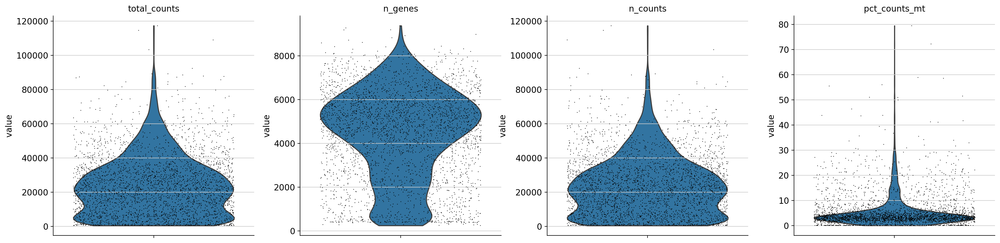

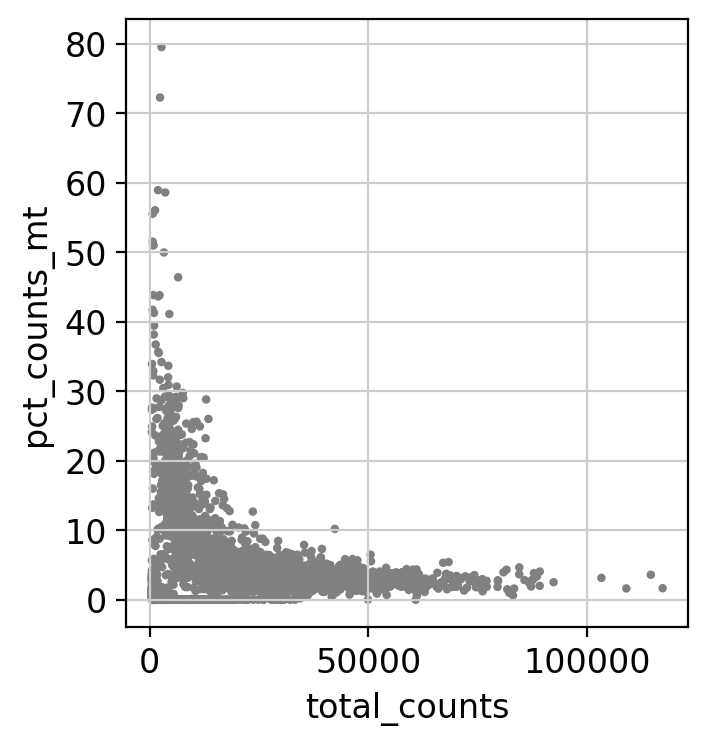

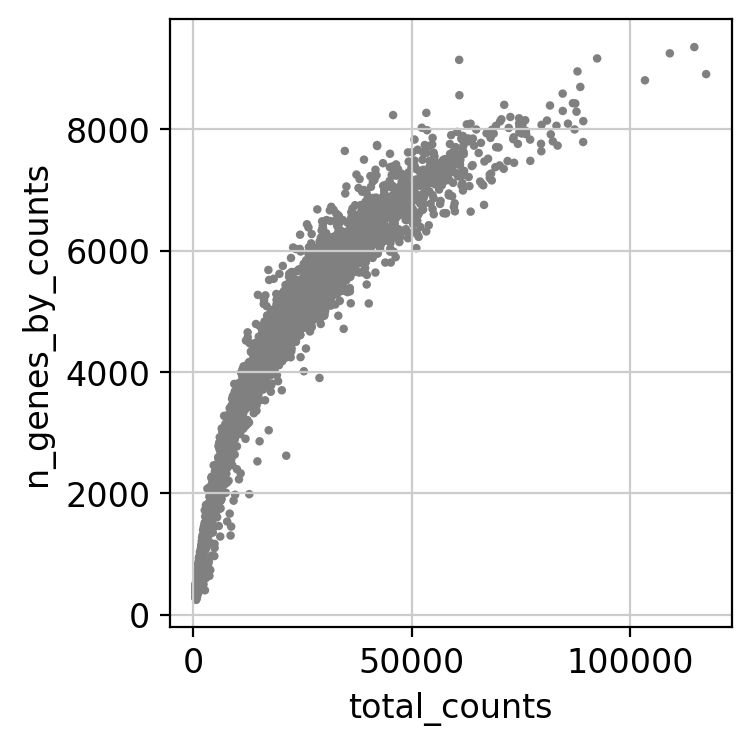

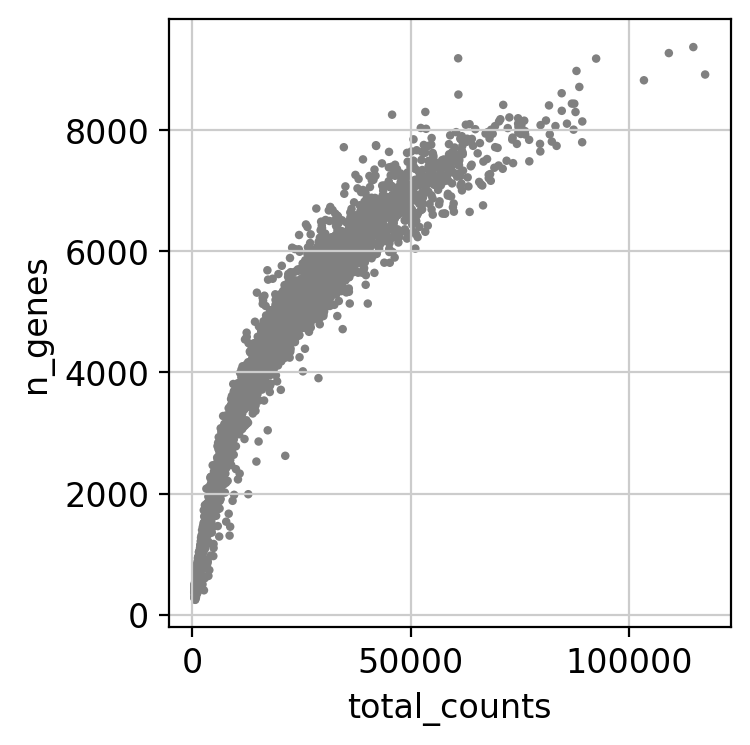

In [15]:
sc.pl.violin(adata, ['total_counts','n_genes', 'n_counts','pct_counts_mt'], jitter=0.4, multi_panel=True ,save='_nGenes_TotalCounts_mouse_MSOD')#l;abels do not work with multipanel
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt',save='_pctMT_total_counts_MSODB' ) #Cut under 10% mit
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts',save='_total_genes_by_counts_MSODB') # cut under 5000 genes by counts
sc.pl.scatter(adata, x='total_counts', y='n_genes',save='_total_counts_vs_totalgenes_MSODB') # cut under 5000 genes by counts

In [16]:
adata

AnnData object with n_obs × n_vars = 3197 × 19054
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

# clean cells with less than 6000 genes by counts, less than 10% mitochondrial genes and more than 90% human reads

In [17]:
adata = adata[adata.obs.n_genes < 7000, :]
adata = adata[adata.obs.n_genes > 2000, :]
adata = adata[adata.obs.total_counts > 10000, : ]
adata = adata[adata.obs.total_counts < 50000, : ]
adata = adata[adata.obs.pct_counts_mt < 10, :]
adata

View of AnnData object with n_obs × n_vars = 1979 × 19054
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [18]:
adata

View of AnnData object with n_obs × n_vars = 1979 × 19054
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [19]:
sc.pp.normalize_total(adata, target_sum=1e4)


normalizing counts per cell
    finished (0:00:00)


/usr/local/lib/python3.8/dist-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [20]:
sc.pp.log1p(adata)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/usr/local/lib/python3.8/dist-packages/numba/core/dispatcher.py:289: UserWarning: Numba extension module 'sparse._numba_extension' failed to load due to 'ContextualVersionConflict((numpy 1.22.0 (/usr/local/lib/python3.8/dist-packages), Requirement.parse('numpy<1.22,>=1.18'), {'numba'}))'.
  entrypoints.init_all()


    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


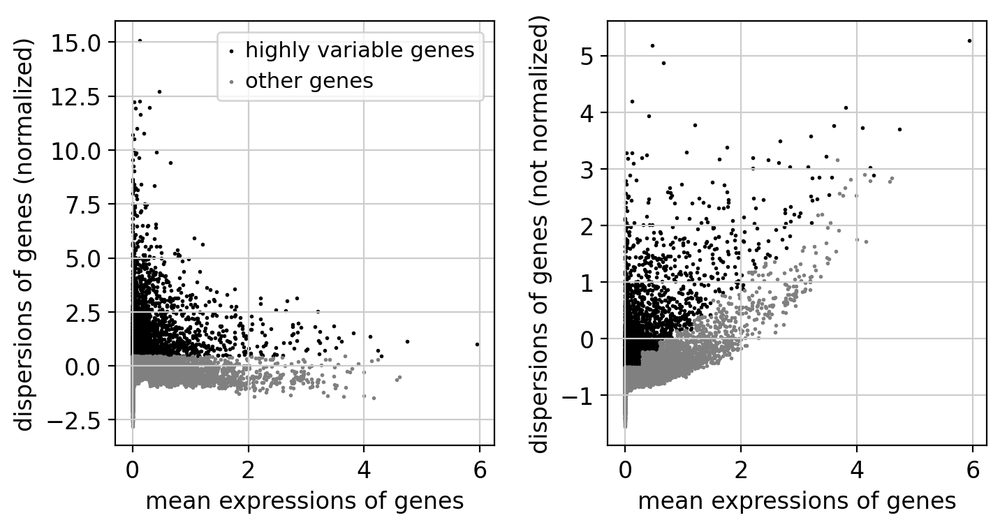

In [21]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5,n_top_genes=3000)
sc.pl.highly_variable_genes(adata, save='_highly_variable_MSOD')

In [22]:
adata.var_names_make_unique()
adata.raw = adata

In [23]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    558 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    557 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


In [24]:
adata = adata[:, adata.var.highly_variable]
adata

View of AnnData object with n_obs × n_vars = 1979 × 3000
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [25]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])


regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/usr/local/lib/python3.8/dist-packages/anndata/_core/anndata.py:1236: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'phase' as categorical


    finished (0:00:11)


In [26]:
sc.pp.scale(adata, max_value=10)

# Export diff expressed genes

In [27]:
with open ('./out/Highly_VariableGenes.txt','w') as fout:
    for gene in list(adata.var_names):
        print(gene, file=fout)

# PCA analysis

In [28]:
adata

AnnData object with n_obs × n_vars = 1979 × 3000
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg'

In [29]:
sc.tl.pca(adata, svd_solver='arpack', n_comps = 70)

computing PCA
    on highly variable genes
    with n_comps=70
    finished (0:00:00)


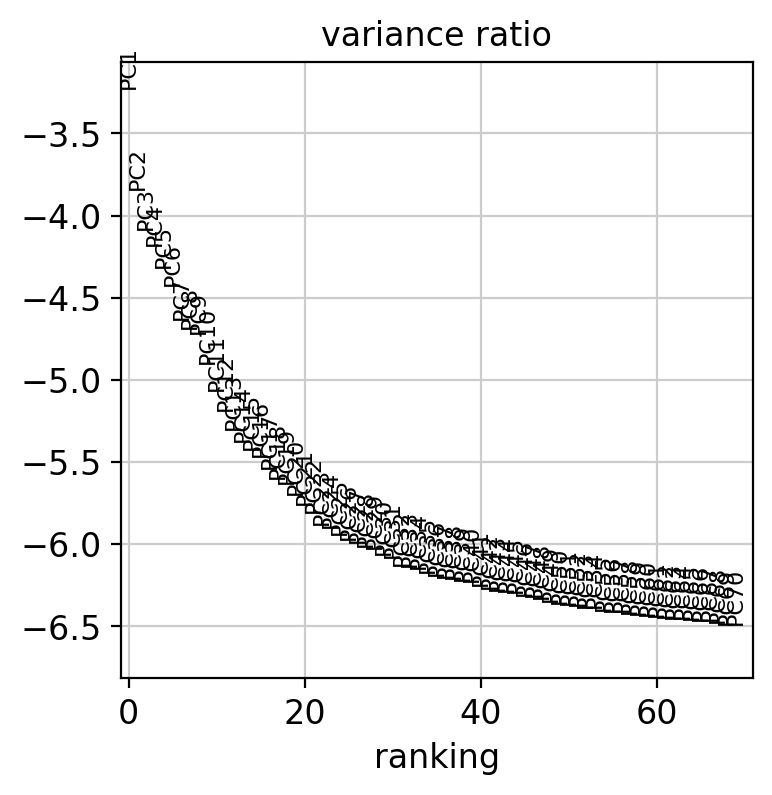

In [30]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=70, save='_PCA_elbow_MSODB')

In [31]:
adata.write(results_file)
adatapp=adata.copy()

# Compute neighborhood graph 

In [32]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=40)
sc.tl.umap(adata,min_dist= 0.25)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [33]:
sc.tl.leiden(adata, resolution= 0.4, key_added='leiden_0.4')
sc.tl.leiden(adata, resolution= 0.47, key_added='leiden_0.47')
sc.tl.leiden(adata, resolution= 0.5, key_added='leiden_0.5')
sc.tl.leiden(adata, resolution= 0.6, key_added='leiden_0.6')
sc.tl.leiden(adata, resolution= 0.8, key_added='leiden_0.8')
sc.tl.leiden(adata, resolution= 1, key_added='leiden_1')


running Leiden clustering
    finished: found 5 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 6 clusters and added
    'leiden_0.47', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_0.8', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 10 clusters and added
    'leiden_1', the cluster labels (adata.obs, categorical) (0:00:00)


In [34]:
adata

AnnData object with n_obs × n_vars = 1979 × 3000
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', 'leiden_0.4', 'leiden_0.47', 'leiden_0.5', 'leiden_0.6', 'leiden_0.8', 'leiden_1'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

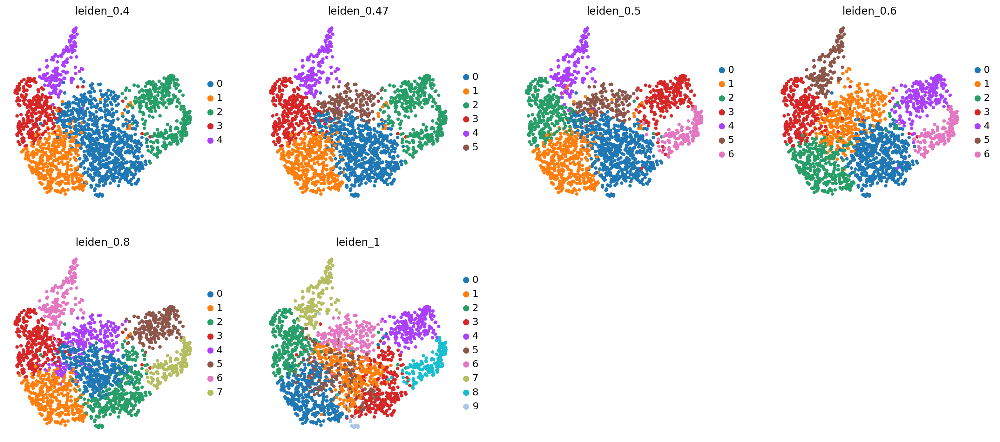

In [35]:
sc.pl.umap(adata, color=['leiden_0.4','leiden_0.47','leiden_0.5','leiden_0.6','leiden_0.8','leiden_1'], save='_UMAPS_leiden')

In [36]:
sc.tl.rank_genes_groups(adata,'leiden_0.47', method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


In [37]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
df = pd.DataFrame(
{group + '_' + key : result[key][group]
for group in groups for key in ['names','logfoldchanges','pvals','pvals_adj','scores']})
df.to_csv('./out/Diff_Exp_Genes.csv')

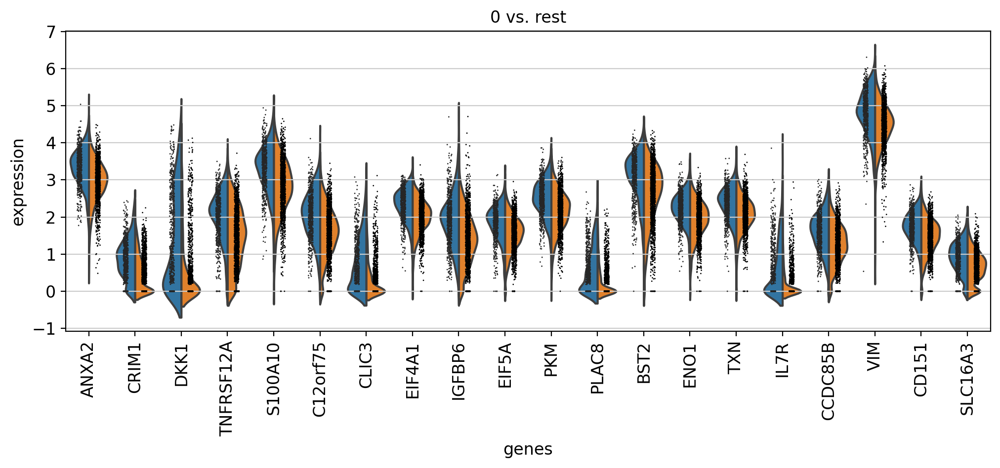

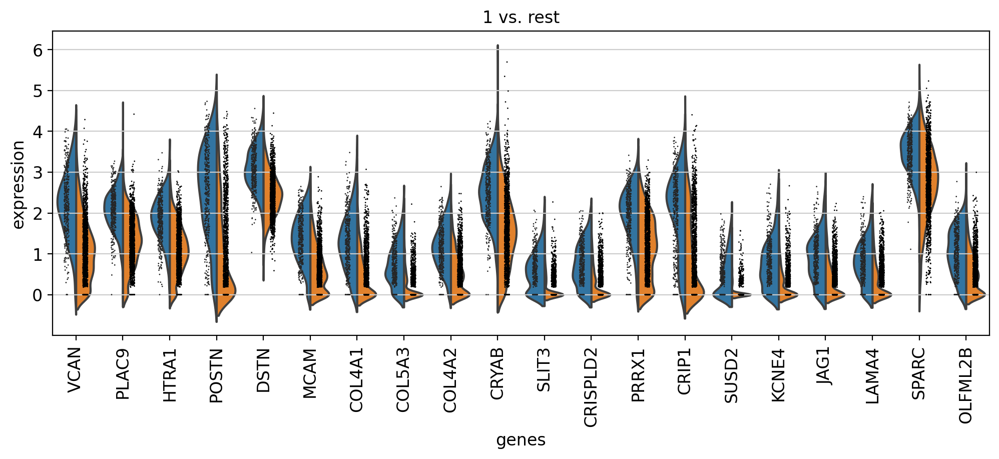

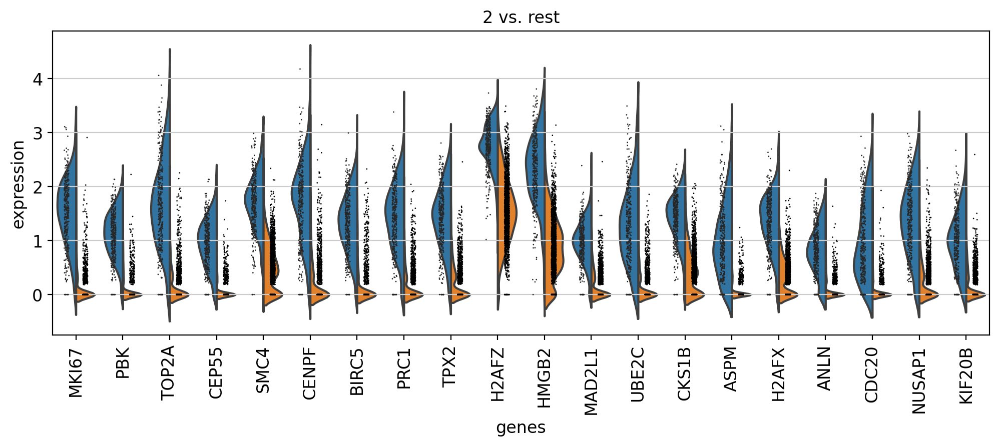

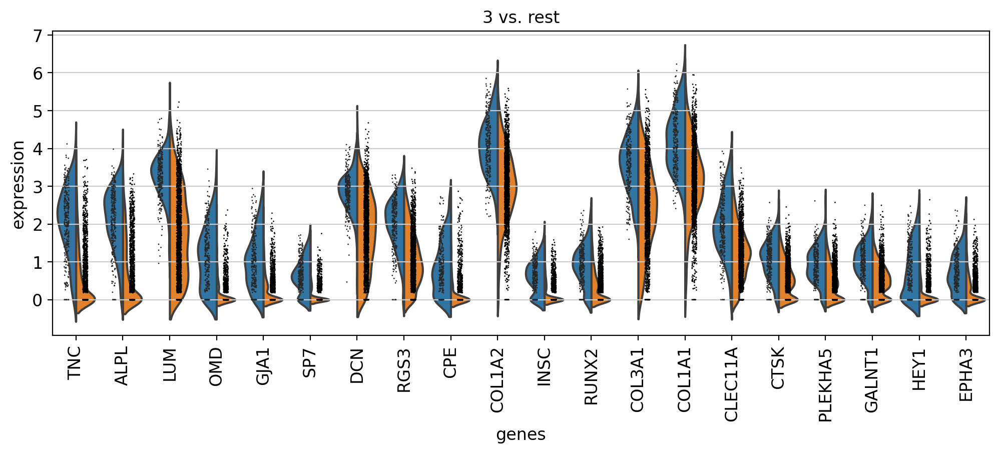

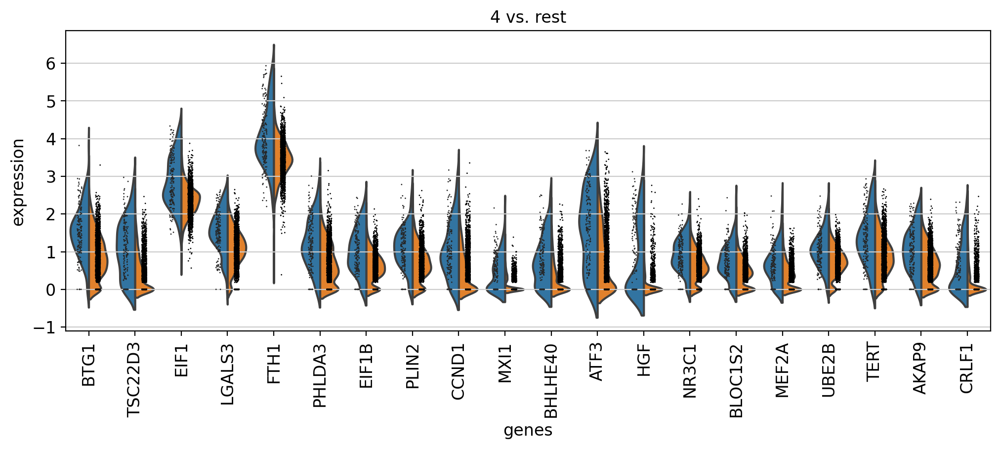

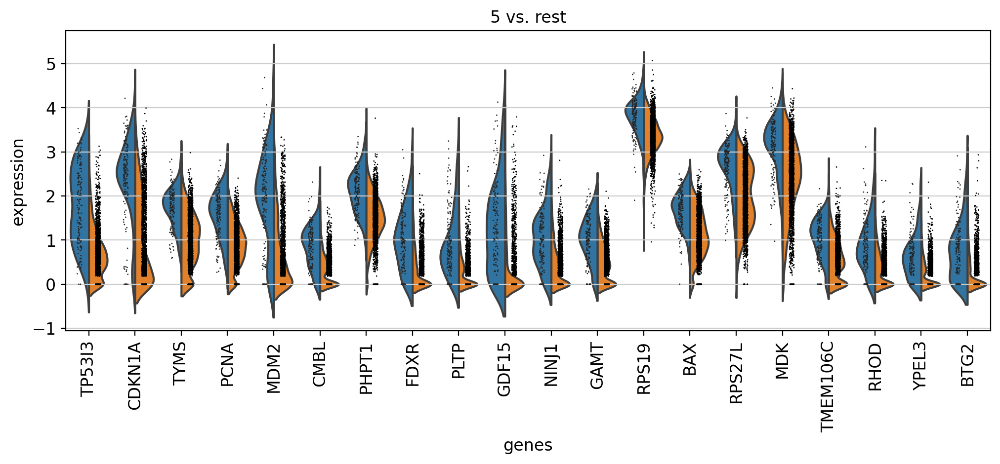

In [38]:
with rc_context({'figure.figsize': (12, 4)}):
    sc.pl.rank_genes_groups_violin(adata, n_genes=20, save= '_rank_genes_MSOD')

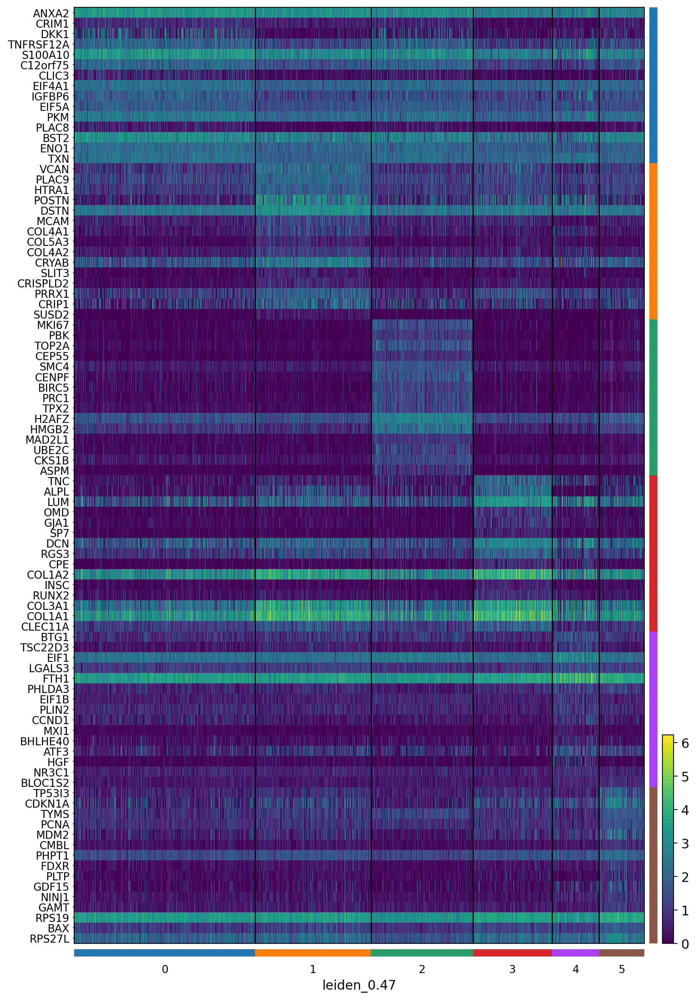

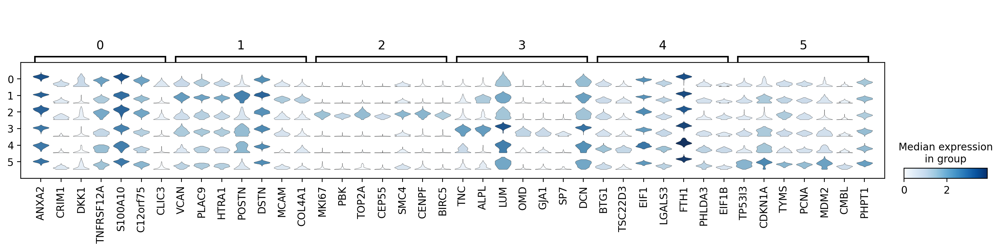

In [39]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=15,dendrogram=False,show_gene_labels=True, save='rankGenes_MSODB',swap_axes=True,cmap='viridis')
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=7,dendrogram=False, save='rankGenes_violin_MSODB')

In [40]:
adata
adata.obs['clusters']=adata.obs['leiden_0.47']

In [41]:
markerdict={
'General' : ['TERT', 'CD74','XIST','SLC7A5','PDGFRB','DKK1','MMP14','PALLD','PTGIR','PTH1R','PTHLH','ANXA1'],
'Hematopoietic support' :['ANGPT1', 'CXCL12','FRZB','IL7R','PDGFRA','PDGFRB', 'KLF4','IL6'],
'Stromal':['MCAM','VCAM1','KITLG','FRZB','THY1','ICAM1','GJA1','CDC42EP3','CDC42EP4','SDC1','SDC2','SDC4','CFD','IFITM3','DCN','PTGDS','APOE'],
'Cell_cycle_Stop': ['MDM2','CDKN1A','TP53I3'],
'Prolif_Stemness' : ['MKI67','KLF4','KLF3','MYC','CCND1'],
'Collagens' : ['COL4A1','COL4A2','COL8A1','COL14A1','COL21A1','COL27A1','COL1A1','COL1A2'],
'Early_Coll' : ['COL5A1','COL5A2','COL5A3'],
'Late_coll' : ['COL9A2','COL9A3','COL11A1','COL11A2'],
'Chondrogenic_markers' : ['ACAN', 'SOX9','RUNX1','RUNX2'],
'OsteoChondro' : ['SPP1','CPE'],
'Osteogenic_markers' : ['FN1','BGLAP','BAP1','ALPL','CDH11','SP7', 'SPP1', 'TNC','BGLAP','HES4','FBN1','NEAT1','SPARCL1','COL3A1','FGF7','GAS6'],
'Fat_tissue' : ['ADIPOR1','ADIPOR2','LEPR','PLIN2','JUNB','FOSB','DEPP1','LMNA','KLF2'],
'Fibroblast' : ['SRGN','S100A1','S100A2','S100A3','S100A4'],
'Inflamation' : ['CCL5','SERPINE1', 'SERPINE2','IL1R1','MMP2','ADAMTS4','LOXL2'],
'TNFs' : ['TNFSF13', 'TNFSF18', 'UBE2L5','TRIM25','PIDD1', 'NFKB1', 'IL1RAP','ERC1']}


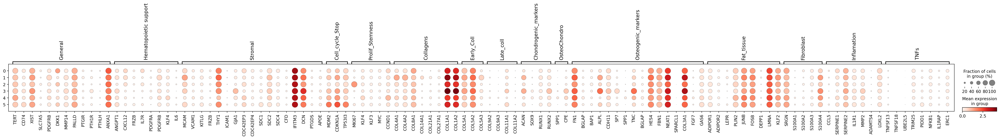

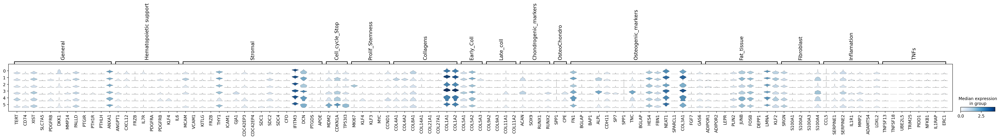

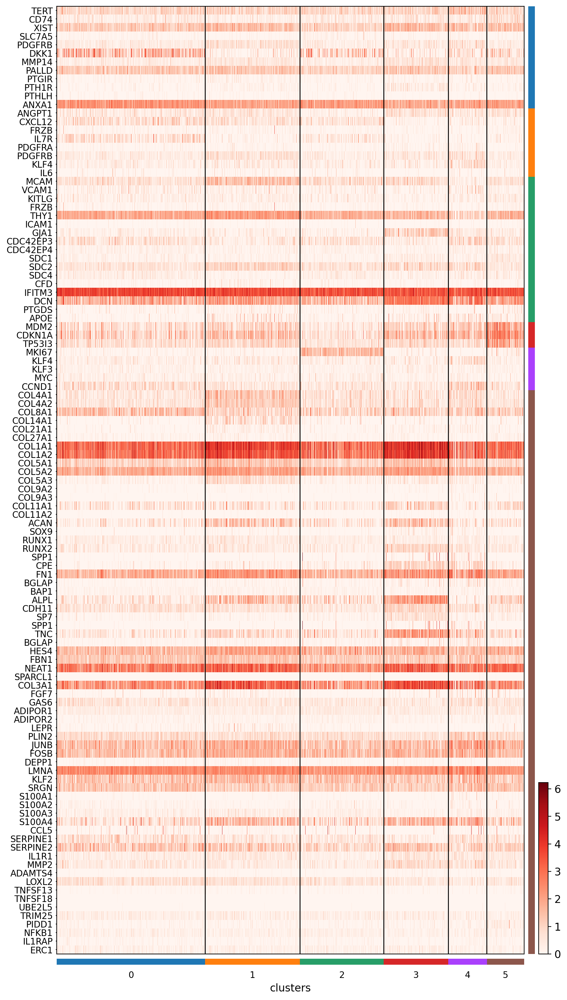

In [42]:
sc.pl.dotplot(adata, markerdict, 'clusters', dendrogram=False, save = 'MarkerGenes_dot')
sc.pl.stacked_violin(adata, markerdict, 'clusters', dendrogram=False, save = 'MarkerGenes_Violin')
sc.pl.heatmap(adata, markerdict, 'clusters', dendrogram=False,show_gene_labels=True, save = 'MarkerGenes_Violin',swap_axes=True)

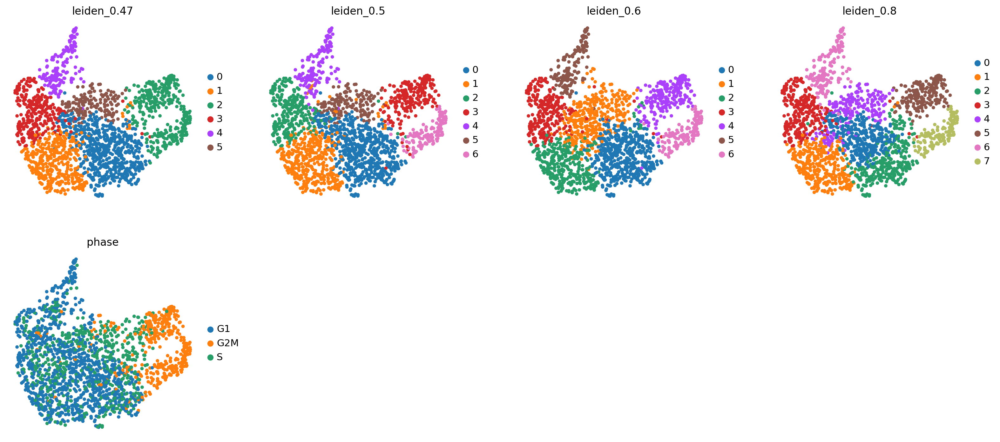

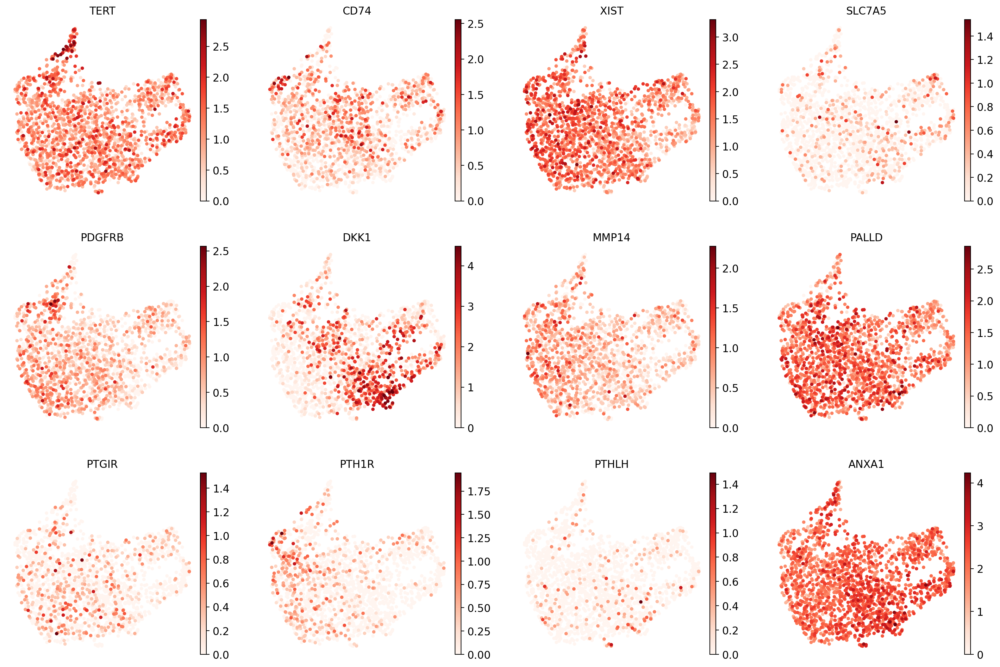

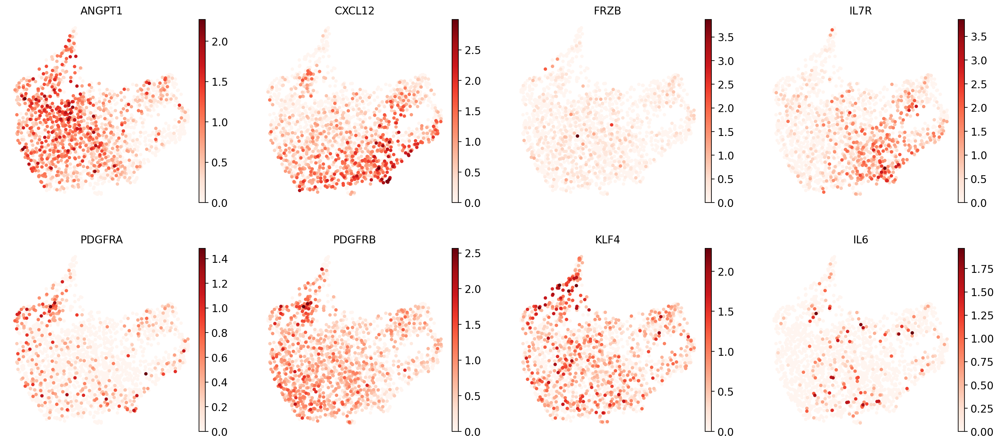

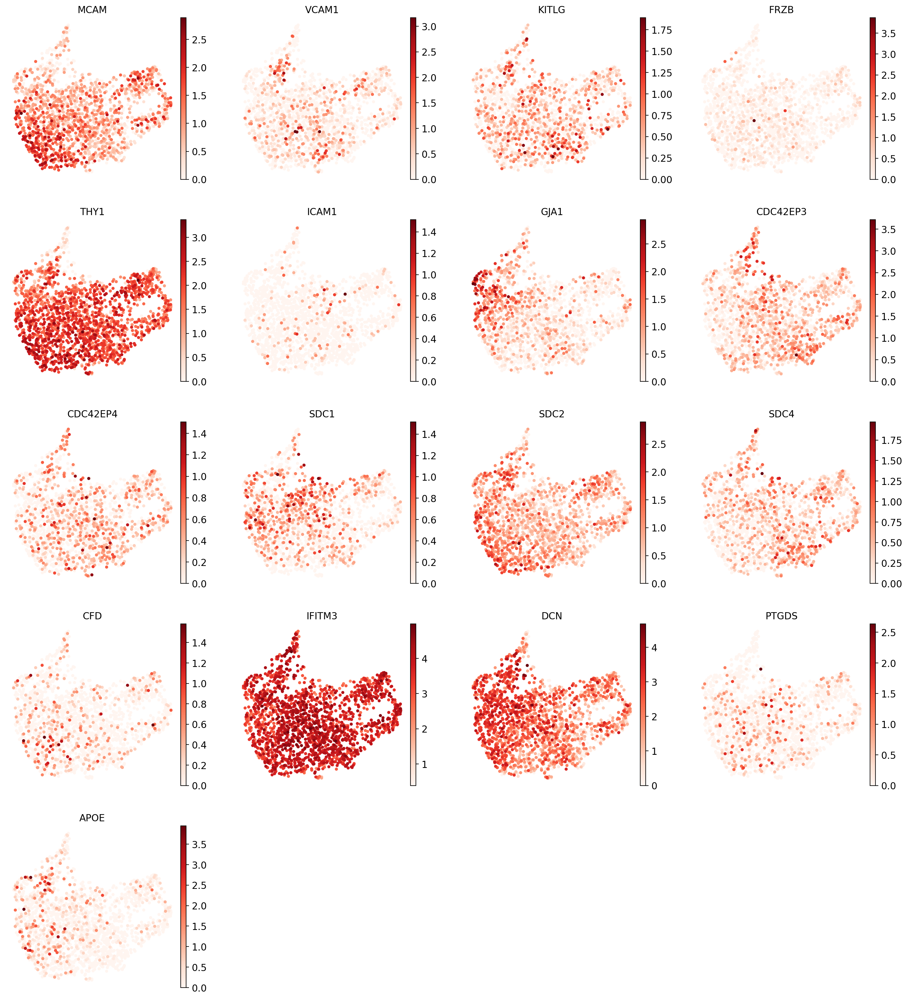

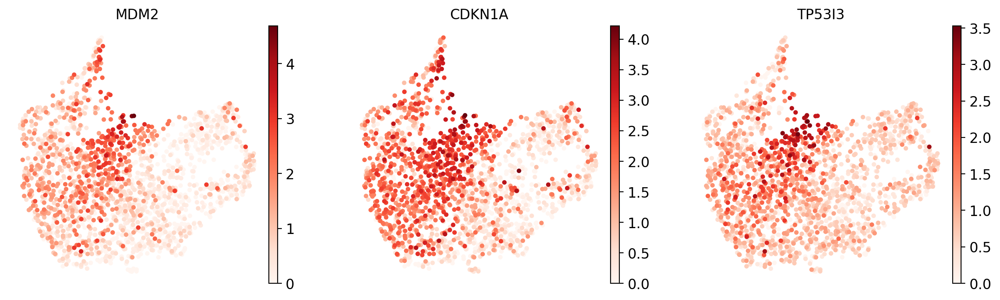

...

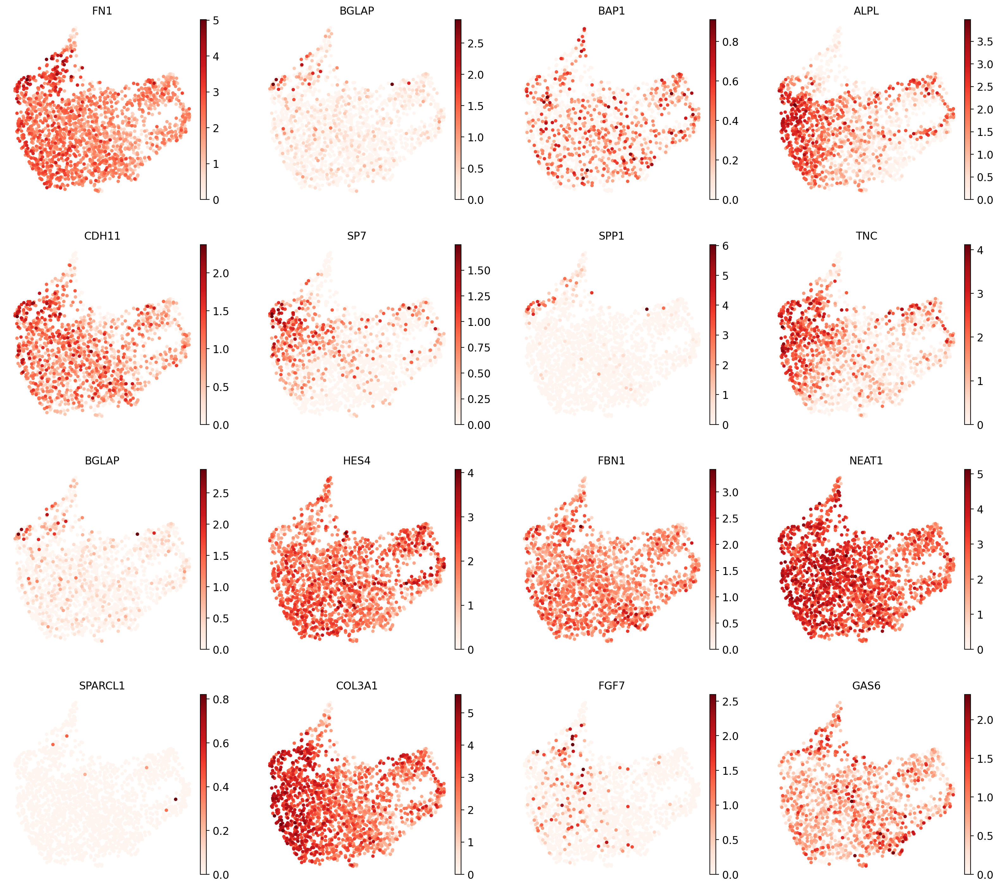

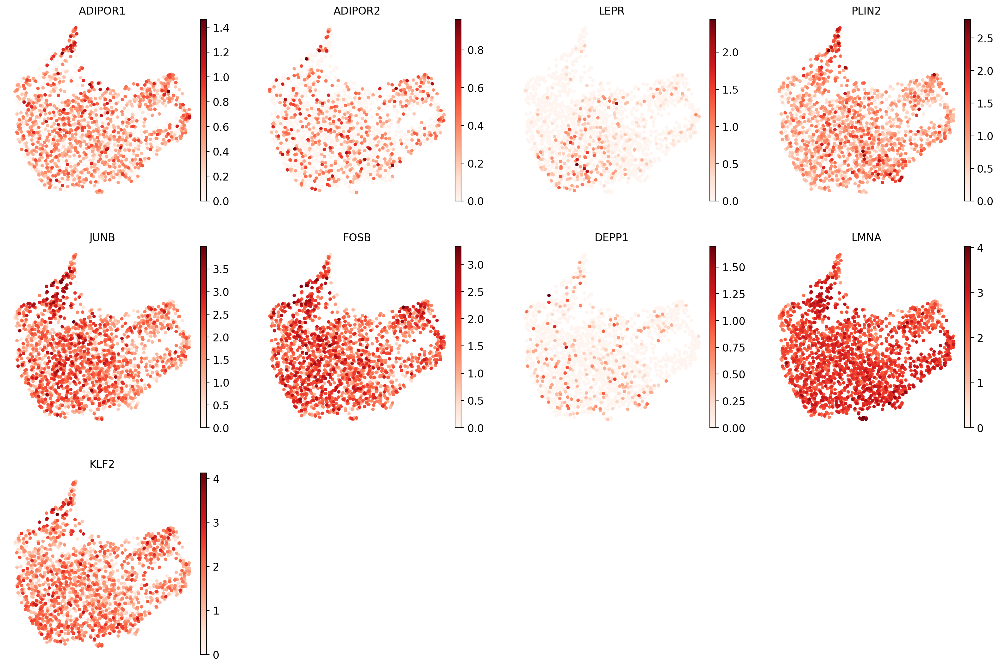

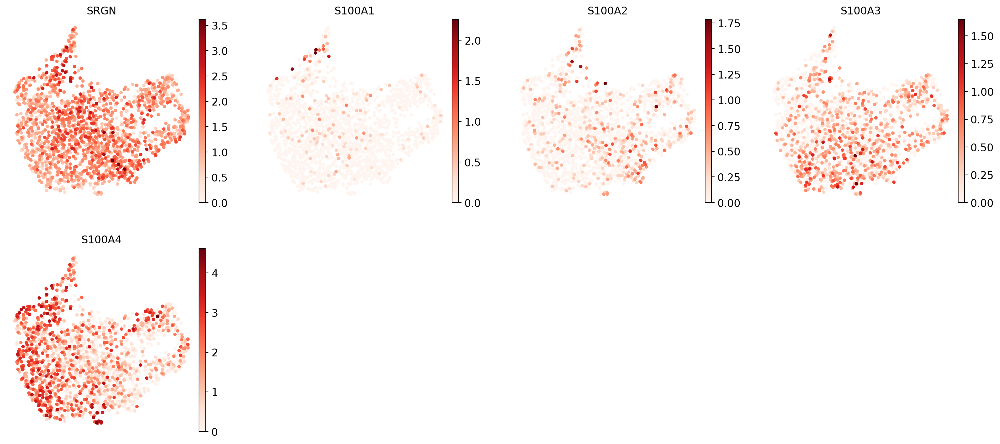

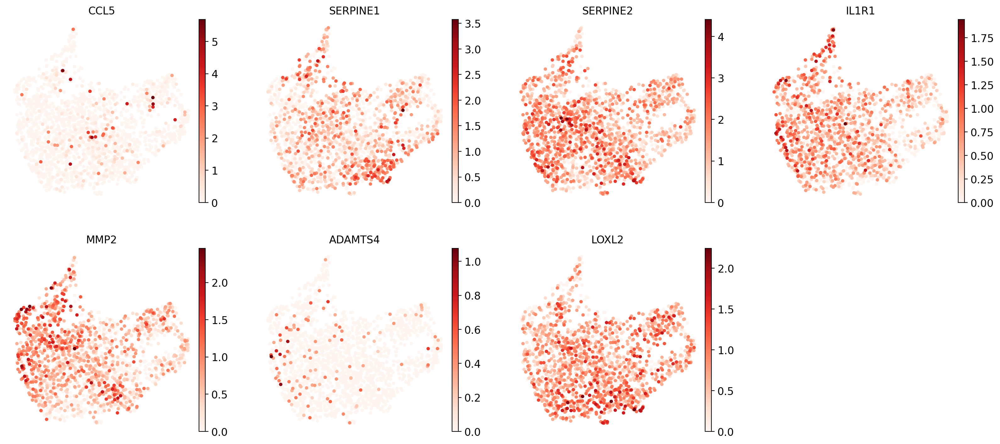

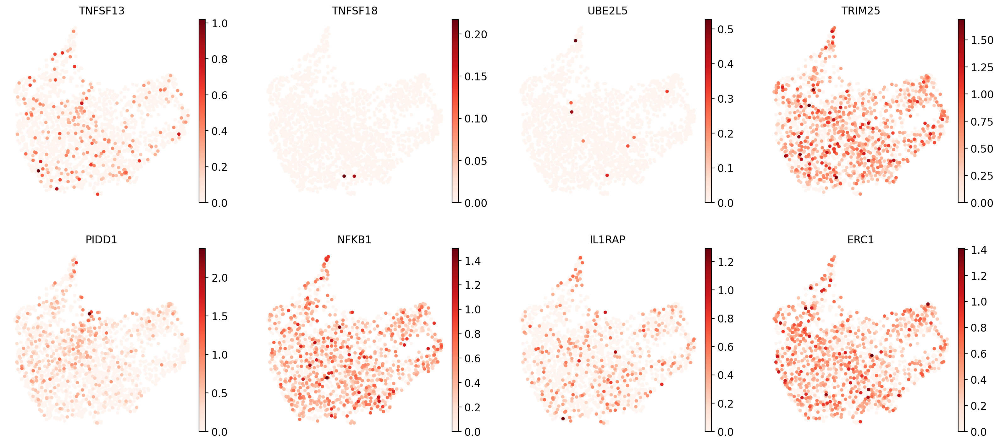

In [43]:
sc.pl.umap(adata, color = ['leiden_0.47','leiden_0.5','leiden_0.6','leiden_0.8','phase'])

for key in markerdict:
    strsave='_'+key+'_MSODB'
    sc.pl.umap(adata, color = markerdict[key],save = strsave)

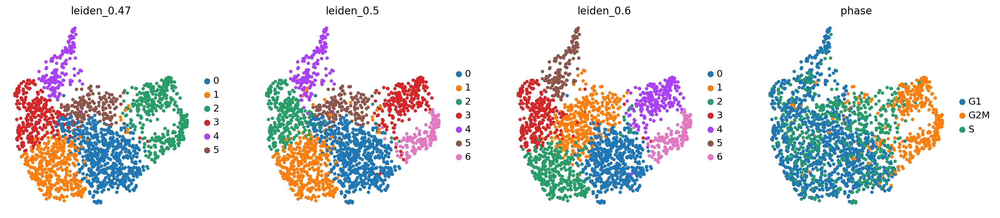

In [44]:
sc.pl.umap(adata, color = ['leiden_0.47','leiden_0.5','leiden_0.6','phase'])

In [45]:
new_cluster_names = ['Stromal', 'Early Chondrocytes','Cycling','Osteo-Like' ,'Hypertrophic Chondrocites', 'Cell-cylce Arrested']

adata.obs['clusters'] = adata.obs['leiden_0.47']
adata.rename_categories('leiden_0.47', new_cluster_names)
adata.obs['cell_types']=adata.obs['leiden_0.47']

/usr/local/lib/python3.8/dist-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


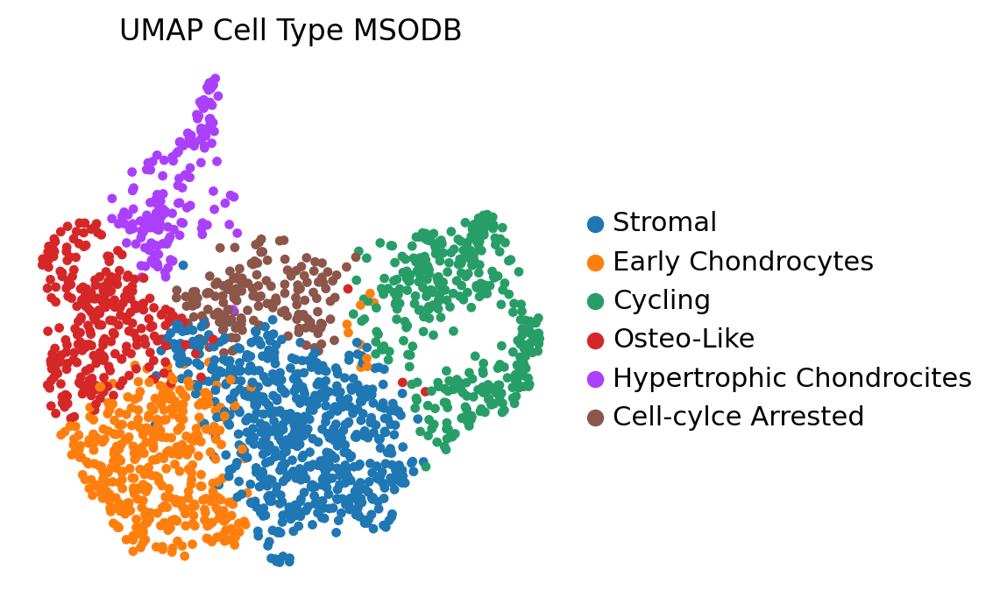

In [46]:
sc.pl.umap(adata, color='cell_types', legend_loc='right margin', title='UMAP Cell Type MSODB',frameon=False, save='UMAP_MSODB_CellTypes.pdf')
#sc.pl.umap(adata, color='leiden0.2', legend_loc='right margin', title='UMAP cluster Rat 3D',projection = '3d',frameon=False, save='.pdf')

In [47]:
adata

AnnData object with n_obs × n_vars = 1979 × 3000
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', 'leiden_0.4', 'leiden_0.47', 'leiden_0.5', 'leiden_0.6', 'leiden_0.8', 'leiden_1', 'clusters', 'cell_types'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_0.4_colors', 'leiden_0.47_colors', 'leiden_0.5_colors', 'leiden_0.6_colors', 'leiden_0.8_colors', 'leiden_1_colors', 'rank_genes_groups', 'clusters_colors', 'phase_colors', 'cell_types_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

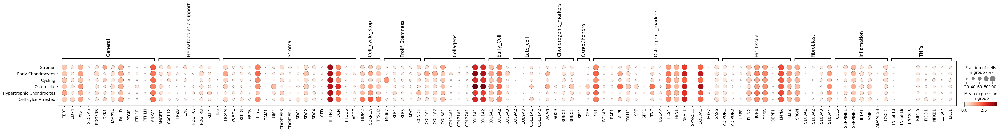

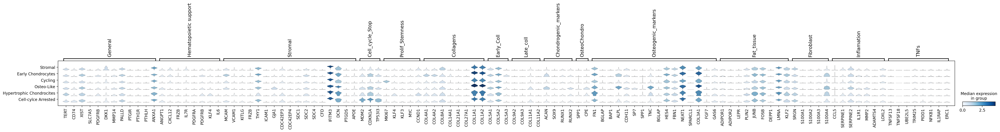

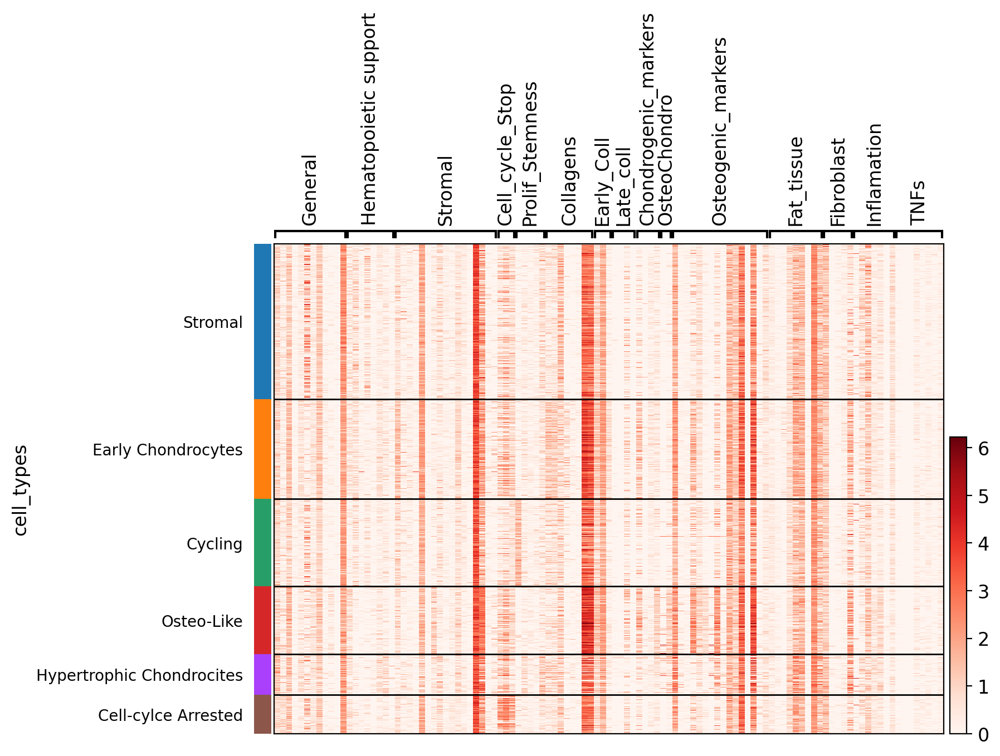

In [48]:
sc.pl.dotplot(adata, markerdict, groupby='cell_types', save='_CellMarker_MSODB')
sc.pl.stacked_violin(adata, markerdict, groupby='cell_types', rotation=90, save='_cellmarker_MSODB')
sc.pl.heatmap(adata, markerdict, groupby='cell_types', dendrogram=False, save= 'Cellmarker_track_MSODB')

In [49]:
adatapp

AnnData object with n_obs × n_vars = 1979 × 3000
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [50]:
adata.var_names

Index(['SAMD11', 'PLEKHN1', 'AL645608.7', 'HES4', 'ISG15', 'TNFRSF18',
       'TNFRSF4', 'C1QTNF12', 'ANKRD65', 'VWA1',
       ...
       'LAGE3', 'CLIC2', 'TMLHE-AS1', 'MT-ND1', 'MT-ND2', 'MT-ATP6', 'MT-ND3',
       'MT-ND4L', 'MT-ND5', 'MT-ND6'],
      dtype='object', length=3000)

In [51]:
adata.write(results_file)
adatapp.write(pp_file)